In [54]:
import os
import sys
import IPython
import IPython.display
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import collections
from numpy import reshape, array
from datetime import datetime, timedelta

import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Conv1D, Flatten, Dense
from tensorflow.keras import layers

cell_type = "lg"
model_type = "cnn_model"
base_path = '../../'

sys.path.append(base_path)
from training import utils

lg_data_path = base_path + 'datasets/Dataset_Li-ion'
pre_trained_path = base_path + 'pre-trained/' + cell_type + '_' + model_type

resample_1hz = True
vi_averages = True

In [55]:
lg_charge_cycles = ['Charge']

lg_train_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_train_discharge_cycles = ['Mixed']

lg_test_temps = ['n10degC', '0degC', '10degC', '25degC']
lg_test_discharge_cycles = ['UDDS', 'HWFET', 'LA92', 'US06']

lg_train_files = utils.lg_get_files(lg_data_path, 
                                    lg_train_discharge_cycles, 
                                    lg_charge_cycles, 
                                    lg_train_temps)

lg_test_files = utils.lg_get_files(lg_data_path, 
                                   lg_test_discharge_cycles,
                                   lg_charge_cycles, 
                                   lg_test_temps)

lg_train, lg_train_norm = utils.lg_create_dataset(lg_train_files, 
                                                  lg_train_discharge_cycles, 
                                                  lg_charge_cycles, 
                                                  vi_averages, 
                                                  resample_1hz)

lg_test, lg_test_norm = utils.lg_create_dataset(lg_test_files, 
                                                lg_test_discharge_cycles, 
                                                lg_charge_cycles, 
                                                vi_averages, 
                                                resample_1hz)

../../datasets/Dataset_Li-ion/25degC/551_Mixed1.csv 77227
../../datasets/Dataset_Li-ion/25degC/551_Mixed2.csv 79172
../../datasets/Dataset_Li-ion/25degC/552_Mixed3.csv 73827
../../datasets/Dataset_Li-ion/25degC/552_Mixed4.csv 80850
../../datasets/Dataset_Li-ion/25degC/552_Mixed5.csv 72184
../../datasets/Dataset_Li-ion/25degC/552_Mixed6.csv 78106
../../datasets/Dataset_Li-ion/25degC/552_Mixed7.csv 73235
../../datasets/Dataset_Li-ion/25degC/552_Mixed8.csv 85915
../../datasets/Dataset_Li-ion/10degC/567_Mixed1.csv 72329
../../datasets/Dataset_Li-ion/10degC/567_Mixed2.csv 77752
../../datasets/Dataset_Li-ion/10degC/571_Mixed4.csv 73929
../../datasets/Dataset_Li-ion/10degC/571_Mixed5.csv 67174
../../datasets/Dataset_Li-ion/10degC/571_Mixed6.csv 73921
../../datasets/Dataset_Li-ion/10degC/571_Mixed7.csv 69325
../../datasets/Dataset_Li-ion/10degC/571_Mixed8.csv 81422
../../datasets/Dataset_Li-ion/0degC/589_Mixed1.csv 67312
../../datasets/Dataset_Li-ion/0degC/589_Mixed2.csv 72303
../../datasets/D

# Train and Test datasets 

## Train :

In [56]:
lg_train.describe()


Time Stamp,Voltage,Current,Temperature,Power,Capacity,Voltage Average,Current Average,Power Average
count,176334.000000,176334.000000,176334.000000,176334.000000,176334.000000,176334.000000,176334.000000,176334.000000
mean,3.665063,-1.333758,7.891981,-4.596105,0.485778,3.699654,-1.296481,-4.522300
std,0.262172,2.561152,12.526156,8.941956,0.267832,0.226606,0.711963,2.410210
min,2.792680,-17.822440,-9.884900,-50.862673,0.000000,3.094354,-3.715850,-11.429077
25%,3.494900,-2.556640,-0.315480,-9.210683,0.269070,3.521361,-1.720026,-5.996818
50%,3.672220,-0.950120,9.359110,-3.477834,0.473796,3.694212,-1.162827,-4.127167
75%,3.859490,-0.097060,23.976150,-0.386161,0.715691,3.889611,-0.772447,-2.722423
max,4.200630,5.999610,26.289630,25.171220,0.978056,4.139058,-0.277316,-1.079428


## Test :


In [57]:
lg_test.describe()


Time Stamp,Voltage,Current,Temperature,Power,Capacity,Voltage Average,Current Average,Power Average
count,104485.000000,104485.000000,104485.000000,104485.000000,104485.000000,104485.000000,104485.000000,104485.000000
mean,3.677951,-1.098654,6.921388,-3.776420,0.484375,3.704737,-1.097331,-3.824287
std,0.261341,2.357463,12.063139,8.243404,0.267702,0.229296,0.728330,2.439860
min,2.794030,-17.610450,-10.095220,-50.864924,0.000000,3.049658,-3.810095,-11.887300
25%,3.496920,-2.191410,-0.420630,-7.916661,0.258278,3.523629,-1.335683,-4.544482
50%,3.689080,-0.625750,9.148790,-2.317480,0.494788,3.716103,-0.867386,-3.073238
75%,3.885750,-0.084280,23.765830,-0.316026,0.714165,3.900654,-0.523847,-1.888219
max,4.200120,5.999610,26.815430,25.142453,0.955909,4.110299,-0.311306,-1.210706


In [58]:
lg_train

Time Stamp,Voltage,Current,Temperature,Power,Capacity,Voltage Average,Current Average,Power Average
0,4.11924,-0.18645,23.87099,-0.768032,0.972001,4.133085,-0.523572,-2.132373
1,4.11317,-0.47251,23.87099,-1.943514,0.971967,4.132942,-0.524415,-2.135832
2,4.10626,-0.76878,23.87099,-3.156811,0.971905,4.132788,-0.525768,-2.141377
3,4.09547,-1.23107,23.87099,-5.041810,0.971801,4.132612,-0.528041,-2.150670
4,4.11014,-0.49549,23.87099,-2.036533,0.971700,4.132466,-0.528838,-2.153931
...,...,...,...,...,...,...,...,...
176329,2.91961,-2.96785,-8.51784,-8.664965,0.002039,3.334978,-1.083477,-3.225658
176330,2.81662,-5.79012,-8.51784,-16.308568,0.001575,3.334203,-1.089342,-3.239959
176331,2.95129,-1.12125,-8.51784,-3.309134,0.000977,3.333552,-1.087911,-3.234542
176332,2.84241,-6.55635,-8.51784,-18.635835,0.000764,3.332554,-1.098112,-3.262086


In [59]:
lg_test

Time Stamp,Voltage,Current,Temperature,Power,Capacity,Voltage Average,Current Average,Power Average
0,4.17113,2.55922,23.97615,10.674839,0.954944,4.110299,-0.845544,-3.395760
1,4.17669,2.75078,23.97615,11.489155,0.955238,4.110283,-0.839941,-3.372355
2,4.16776,2.26039,23.97615,9.420763,0.955485,4.110252,-0.835226,-3.352701
3,4.15326,1.54779,23.97615,6.428374,0.955655,4.110193,-0.831936,-3.339032
4,4.14652,1.23108,23.97615,5.104698,0.955790,4.110120,-0.829280,-3.328011
...,...,...,...,...,...,...,...,...
104480,3.21807,1.80831,-6.30951,5.819268,0.001352,3.100237,-2.803562,-7.848327
104481,3.17677,0.03065,-6.30951,0.097368,0.001526,3.100945,-2.783114,-7.790577
104482,2.98787,-4.46455,-6.30951,-13.339495,0.001380,3.101158,-2.777138,-7.774308
104483,3.28010,3.00108,-6.30951,9.843843,0.001089,3.101938,-2.757206,-7.714365


In [60]:
lg_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 176334 entries, 0 to 176333
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Voltage          176334 non-null  float64
 1   Current          176334 non-null  float64
 2   Temperature      176334 non-null  float64
 3   Power            176334 non-null  float64
 4   Capacity         176334 non-null  float64
 5   Voltage Average  176334 non-null  float64
 6   Current Average  176334 non-null  float64
 7   Power Average    176334 non-null  float64
dtypes: float64(8)
memory usage: 10.8 MB


In [61]:
lg_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104485 entries, 0 to 104484
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Voltage          104485 non-null  float64
 1   Current          104485 non-null  float64
 2   Temperature      104485 non-null  float64
 3   Power            104485 non-null  float64
 4   Capacity         104485 non-null  float64
 5   Voltage Average  104485 non-null  float64
 6   Current Average  104485 non-null  float64
 7   Power Average    104485 non-null  float64
dtypes: float64(8)
memory usage: 6.4 MB


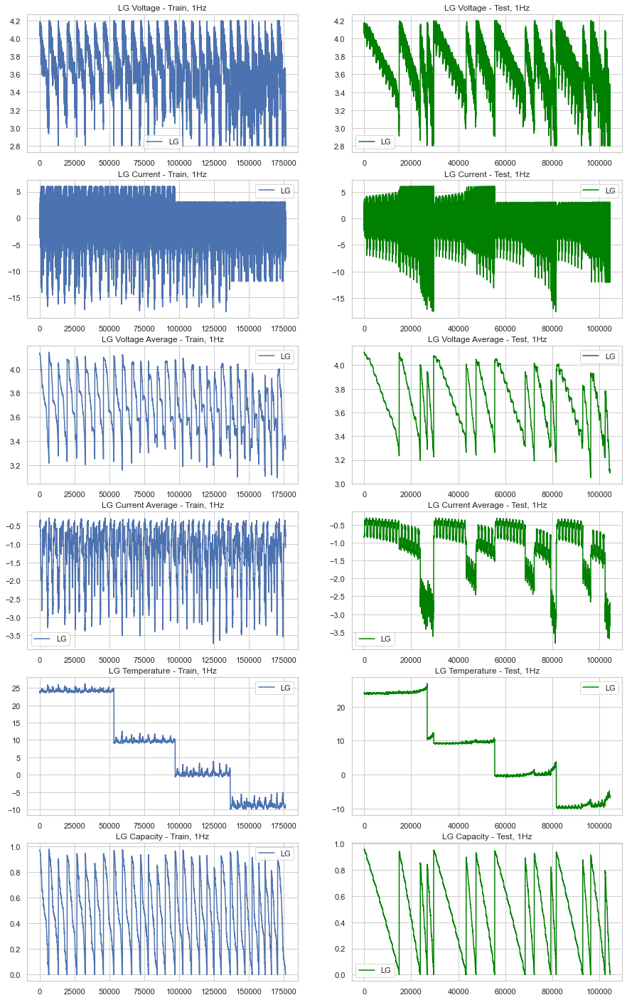

In [62]:
plot_cols = ['Voltage', 'Current', 'Voltage Average', 'Current Average', 'Temperature', 'Capacity']

fig, axs = plt.subplots(nrows=len(plot_cols), ncols=2, figsize=(15, 25))

for i, col in enumerate(plot_cols):
    axs[i, 0].plot(lg_train[col], label='LG')
    axs[i, 0].set_title(f'LG {col} - Train, 1Hz')
    axs[i, 0].legend()
    
    axs[i, 1].plot(lg_test[col], label='LG', color="green")
    axs[i, 1].set_title(f'LG {col} - Test, 1Hz')
    axs[i, 1].legend()

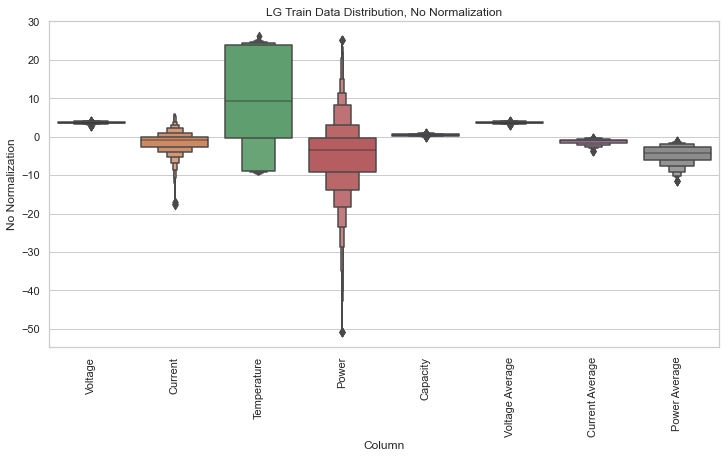

In [63]:
# Melt the DataFrame for seaborn compatibility
df_std = lg_train.melt(var_name='Column', value_name='No Normalization')

# Create a figure for the boxen plot
plt.figure(figsize=(12, 6))

# Create the boxen plot
ax = sns.boxenplot(x='Column', y='No Normalization', data=df_std)

# Set the x-tick labels with a rotation for better readability
ax.set_xticklabels(lg_train.keys(), rotation=90)

# Set the title of the plot
ax.set_title(label='LG Train Data Distribution, No Normalization')

# Display the plot
plt.show()

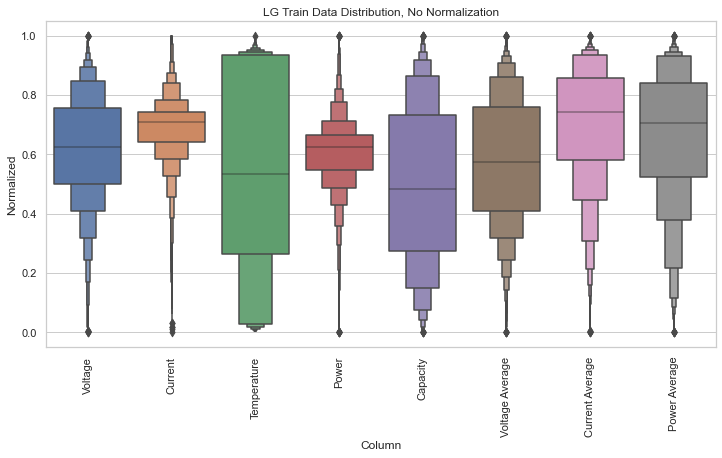

In [64]:
# Melt the DataFrame for seaborn compatibility
df_std = lg_train_norm.melt(var_name='Column', value_name='Normalized')

# Create a figure for the boxen plot
plt.figure(figsize=(12, 6))

# Create the boxen plot
ax = sns.boxenplot(x='Column', y='Normalized', data=df_std)

# Set the x-tick labels with a rotation for better readability
ax.set_xticklabels(lg_train.columns, rotation=90)

# Set the title of the plot
ax.set_title(label='LG Train Data Distribution, No Normalization')

# Display the plot
plt.show()

Text(0.5, 1.01, 'Pair Plot, LG Training Dataset')

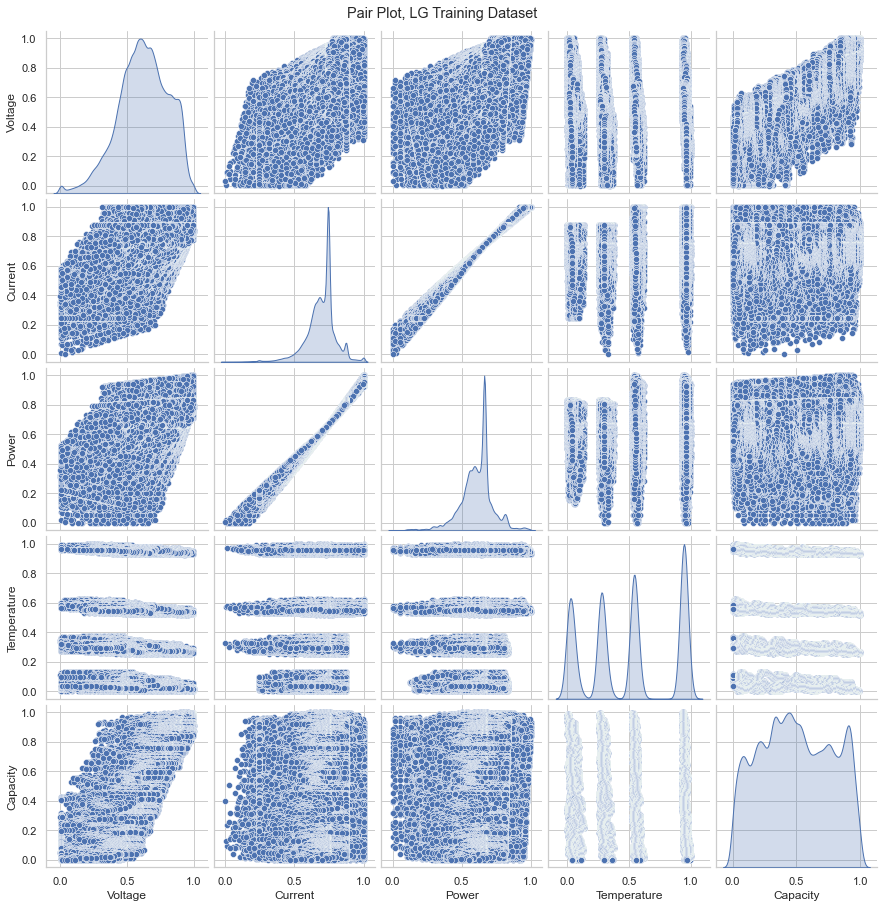

In [65]:
ax = sns.pairplot(lg_train_norm[['Voltage', 'Current', 'Power', 'Temperature', 'Capacity']], diag_kind='kde')
ax.fig.suptitle("Pair Plot, LG Training Dataset", y = 1.01) 

# CNN implementation


In [66]:
train_features = lg_train_norm
test_features = lg_test_norm

train_labels = train_features.pop('Capacity')
test_labels = test_features.pop('Capacity')

In [67]:
train_labels

0         0.993809
1         0.993773
2         0.993710
3         0.993604
4         0.993501
            ...   
176329    0.002085
176330    0.001610
176331    0.000999
176332    0.000781
176333    0.000126
Name: Capacity, Length: 176334, dtype: float64

In [68]:
# reshape for CNN 1-D
train_array = array(train_features)
labels_array = array(train_labels)

sample_size = train_features.shape[0]
time_steps = train_features.shape[1]

input_dimension = 1

train_reshaped = train_array.reshape((sample_size,time_steps,1))
labels_reshaped = labels_array.reshape((train_labels.shape[0],1,1))

print(train_reshaped.shape)
print(labels_reshaped.shape)

(176334, 7, 1)
(176334, 1, 1)


In [80]:
# cnn model definition
cnn_model = Sequential()
cnn_model.add(Conv1D(filters=32,
                     kernel_size=(train_features.shape[1],),
                     activation='relu'))
cnn_model.add(Flatten())
cnn_model.add(Dense(32, activation='relu'))
cnn_model.add(Dense(1))

cnn_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mean_absolute_error', 
                  metrics=['mae'])

In [81]:
history = cnn_model.fit(
    train_reshaped, 
    train_labels,             
    epochs=25, batch_size=32, 
    verbose=1, validation_split=0.2)

Epoch 1/25
4409/4409 [==============================] - 7s 1ms/step - loss: 0.0190 - mae: 0.0190 - val_loss: 0.0274 - val_mae: 0.0274
Epoch 2/25
4409/4409 [==============================] - 5s 1ms/step - loss: 0.0110 - mae: 0.0110 - val_loss: 0.0272 - val_mae: 0.0272
Epoch 3/25
4409/4409 [==============================] - 5s 1ms/step - loss: 0.0100 - mae: 0.0100 - val_loss: 0.0257 - val_mae: 0.0257
Epoch 4/25
4409/4409 [==============================] - 5s 1ms/step - loss: 0.0097 - mae: 0.0097 - val_loss: 0.0308 - val_mae: 0.0308
Epoch 5/25
4409/4409 [==============================] - 5s 1ms/step - loss: 0.0092 - mae: 0.0092 - val_loss: 0.0260 - val_mae: 0.0260
Epoch 6/25
4409/4409 [==============================] - 5s 1ms/step - loss: 0.0090 - mae: 0.0090 - val_loss: 0.0254 - val_mae: 0.0254
Epoch 7/25
4409/4409 [==============================] - 5s 1ms/step - loss: 0.0088 - mae: 0.0088 - val_loss: 0.0242 - val_mae: 0.0242
Epoch 8/25
4409/4409 [==============================] - 5s 1ms

In [82]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,loss,mae,val_loss,val_mae,epoch
20,0.007738,0.007738,0.022670,0.022670,20
21,0.007688,0.007688,0.026934,0.026934,21
22,0.007653,0.007653,0.027577,0.027577,22
23,0.007635,0.007635,0.027032,0.027032,23
24,0.007521,0.007521,0.023475,0.023475,24


3266/3266 - 2s - loss: 0.0206 - mae: 0.0206 - 2s/epoch - 693us/step
3266/3266 [==============================] - 2s 736us/step


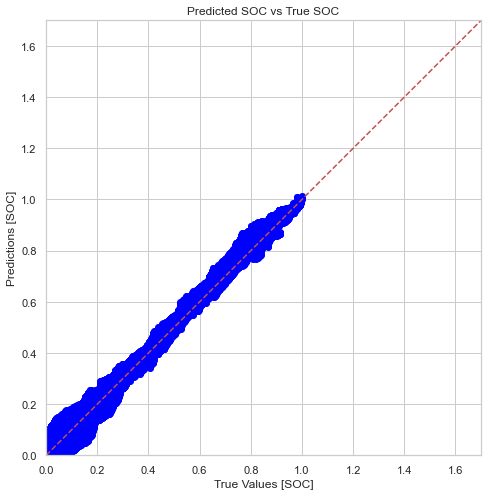

In [83]:
test_results = cnn_model.evaluate(test_features, test_labels, verbose=2)

# Generate predictions on the test set
test_predictions = cnn_model.predict(test_features).flatten()

# Plotting the real SOC vs. predicted SOC
plt.figure(figsize=(8, 8))
a = plt.axes(aspect='equal')
plt.scatter(test_labels, test_predictions, color='blue')  # Plot true vs. predicted
plt.xlabel('True Values [SOC]')
plt.ylabel('Predictions [SOC]')

# Draw a line representing perfect predictions (y = x)
lims = [0, 1.7]  # Adjust based on your SOC range
plt.xlim(lims)
plt.ylim(lims)
plt.plot(lims, lims, 'r--')  # Dashed red line for the ideal case

# Add title
plt.title('Predicted SOC vs True SOC')

# Show the plot
plt.show()

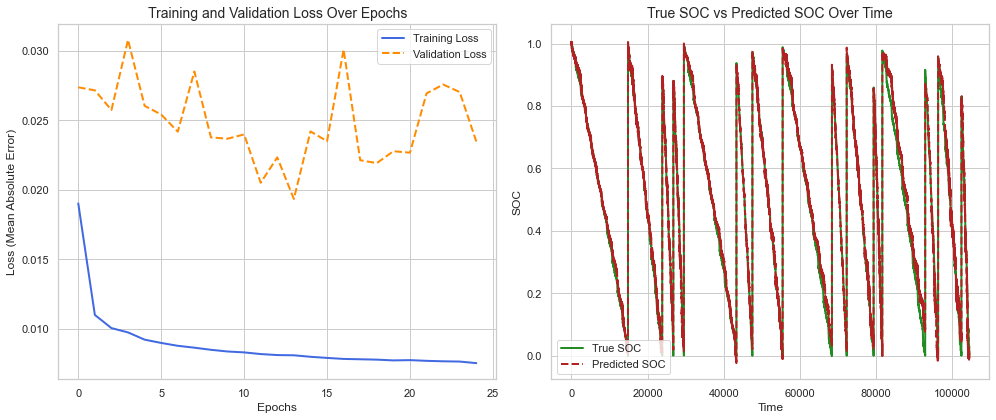

In [84]:
import seaborn as sns

# Set a modern theme using seaborn
sns.set(style="whitegrid")

# Plotting the loss over epochs
plt.figure(figsize=(14, 6))

# Loss plot
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss', color='royalblue', linestyle='-', linewidth=2)
plt.plot(history.history['val_loss'], label='Validation Loss', color='darkorange', linestyle='--', linewidth=2)
plt.xlabel('Epochs')
plt.ylabel('Loss (Mean Absolute Error)')
plt.title('Training and Validation Loss Over Epochs', fontsize=14)
plt.legend()
plt.grid(True)

# Prediction vs True SOC over time
plt.subplot(1, 2, 2)
plt.plot(test_labels, label='True SOC', color='forestgreen', linestyle='-', linewidth=2)
plt.plot(test_predictions, label='Predicted SOC', color='firebrick', linestyle='--', linewidth=2)
plt.xlabel('Time')
plt.ylabel('SOC')
plt.title('True SOC vs Predicted SOC Over Time', fontsize=14)
plt.legend()
plt.grid(True)

# Tight layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()


In [85]:
from sklearn.metrics import r2_score

# Calculate R-squared
r2 = r2_score(test_labels, test_predictions)

print(f"R-squared: {r2:.2f}")

R-squared: 0.99


In [86]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error, explained_variance_score

# True and predicted values
y_true = test_labels
y_pred = test_predictions

# Calculating various metrics
mae = mean_absolute_error(y_true, y_pred)
mse = mean_squared_error(y_true, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_true, y_pred)
explained_variance = explained_variance_score(y_true, y_pred)

print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")
print(f"R-squared: {r2:.3f}")
print(f"Explained Variance: {explained_variance:.3f}")


MAE: 0.021
MSE: 0.001
RMSE: 0.028
R-squared: 0.990
Explained Variance: 0.993


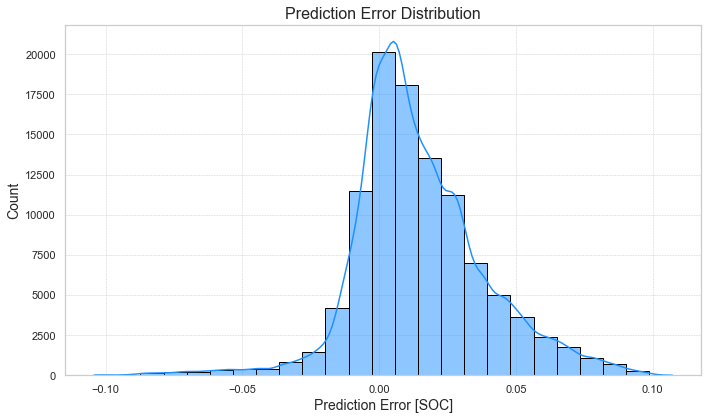

In [87]:

# Set a modern theme using Seaborn
sns.set(style="whitegrid")

# Calculate the prediction errors
error = test_predictions - test_labels

# Plotting the histogram of prediction errors
plt.figure(figsize=(10, 6))

# Using Seaborn's histogram plotting function for enhanced style
sns.histplot(error, bins=25, kde=True, color='dodgerblue', edgecolor='black')

# Adding labels and title
plt.xlabel('Prediction Error [SOC]', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.title('Prediction Error Distribution', fontsize=16)

# Enhancing the grid
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

# Tight layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


In [88]:
import plotly.graph_objects as go
import numpy as np


cycle_num = 0
steps_num = 100000
step_index = np.arange(cycle_num*steps_num, (cycle_num+1)*steps_num)

fig = go.Figure()
fig.add_trace(go.Scatter(x=step_index, y=test_predictions[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Predicted'))
fig.add_trace(go.Scatter(x=step_index, y=test_labels[cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='SOC Actual'))
fig.add_trace(go.Scatter(x=step_index, y=lg_test_norm['Temperature'][cycle_num*steps_num:(cycle_num+1)*steps_num],
                    mode='lines', name='Temperature'))
fig.update_layout(title='Result on Test Dataset',
                  xaxis_title='Step',
                  yaxis_title='SOC Percentage')
fig.show()

In [89]:
# Training MAE
train_mae = history.history['mae']

# Validation MAE
val_mae = history.history['val_mae']


In [90]:
# Assuming the previous code has been executed and the following variables are available:
# train_mae, val_mae, test_mae

# Create a DataFrame to store the results
results_df = pd.DataFrame({
    "Epoch": range(1, len(train_mae) + 1),
    "Training MAE": train_mae,
    "Validation MAE": val_mae
})

# Display the final MAE values for Training, Validation, and Test
final_results_df = pd.DataFrame({
    "Metric": ["Training MAE", "Validation MAE", "Test MAE"],
    "Value": [train_mae[-1], val_mae[-1], mae]
})

# Print the results table
print("Training and Validation MAE per Epoch:")
print(results_df)

print("\nFinal MAE Results:")
print(final_results_df)


Training and Validation MAE per Epoch:
    Epoch  Training MAE  Validation MAE
0       1      0.019015        0.027376
1       2      0.010991        0.027156
2       3      0.010043        0.025742
3       4      0.009733        0.030788
4       5      0.009211        0.026039
5       6      0.008975        0.025417
6       7      0.008769        0.024182
7       8      0.008634        0.028515
8       9      0.008482        0.023768
9      10      0.008360        0.023675
10     11      0.008295        0.023981
11     12      0.008175        0.020504
12     13      0.008102        0.022332
13     14      0.008085        0.019338
14     15      0.007979        0.024201
15     16      0.007897        0.023496
16     17      0.007824        0.030095
17     18      0.007799        0.022127
18     19      0.007773        0.021917
19     20      0.007718        0.022774
20     21      0.007738        0.022670
21     22      0.007688        0.026934
22     23      0.007653        0.027577
2